### Preprocess Images
    - Use YOLO model to detect humans, crop image and use for image classification

In [4]:
import cv2
import numpy as np
import os
from pathlib import Path
import urllib.request
import os
import pandas as pd
import requests
import tensorflow as tf
from tensorflow.keras import layers, models
import matplotlib.pyplot as plt
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns

- **Download YOLO Model**
    - Download weights from: https://github.com/patrick013/Object-Detection---Yolov3/blob/master/model/yolov3.weights
    - Add the weights inside the yolo_files folder

In [17]:
os.makedirs("yolo_files", exist_ok=True)

# Download YOLOv3 config if it doesn't exist
config_path = "./yolo_files/yolov3.cfg"
if not os.path.exists(config_path):
    print("Downloading YOLOv3 config...")
    urllib.request.urlretrieve(
        "https://raw.githubusercontent.com/pjreddie/darknet/master/cfg/yolov3.cfg", 
        config_path
    )

- **Function to detect humans in image**

In [30]:
def detect_people(image_path, output_dir=None):
    """
    Detect people in images using OpenCV's DNN module with a pre-trained YOLO model
    
    Args:
        image_path: Path to the image
        output_dir: Optional directory to save cropped images
    
    Returns:
        List of cropped images containing people
    """
    # Load YOLO model
    net = cv2.dnn.readNetFromDarknet(
        "./yolo_files/yolov3.cfg", 
        "./yolo_files/yolov3.weights"
    )
    
    # Load image
    image = cv2.imread(image_path)
    if image is None:
        print(f"Could not read image: {image_path}")
        return []
    
    # Get image dimensions
    height, width = image.shape[:2]
    
    # Create blob from image
    blob = cv2.dnn.blobFromImage(image, 1/255.0, (416, 416), swapRB=True, crop=False)
    
    # Set input to the network
    net.setInput(blob)
    
    # Get output layer names
    layer_names = net.getLayerNames()
    output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers().flatten()]
    
    # Forward pass
    outputs = net.forward(output_layers)
    
    # Process detections
    class_ids = []
    confidences = []
    boxes = []
    
    for output in outputs:
        for detection in output:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            
            # Filter for person class (class ID 0 in COCO dataset)
            if class_id == 0 and confidence > 0.5:
                # Object detected is a person with confidence > 50%
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)
                
                # Rectangle coordinates
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)
    
    # Apply non-maximum suppression
    indices = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)
    
    # Crop images of people
    cropped_people = {}
    
    if len(indices) > 0:
        for i in indices.flatten():
            x, y, w, h = boxes[i]
            # Ensure box is within image boundaries
            x, y = max(0, x), max(0, y)
            w = min(width - x, w)
            h = min(height - y, h)
            
            # Crop the person from the image
            person_crop = image[y:y+h, x:x+w]
            
            # Save cropped image if output directory is specified
            if output_dir:
                os.makedirs(output_dir, exist_ok=True)
                base_name = Path(image_path).stem
                output_path = f"{output_dir}/{base_name}_person_{i}.jpg"
                cropped_people[output_path] = person_crop
                cv2.imwrite(output_path, person_crop)
    
    return cropped_people

# Example usage:
# detected_people = detect_people("../a1_images/000000087144.jpg", "../output_crops")

- **Function to add noise to images**

In [31]:
def add_noise(image):
    """Add Gaussian noise to an image"""
    row, col, ch = image.shape
    mean = 0
    var = 0.1
    sigma = var**0.5
    gauss = np.random.normal(mean, sigma, (row, col, ch))
    gauss = gauss.reshape(row, col, ch)
    noisy = image + gauss * 25
    return np.clip(noisy, 0, 255).astype(np.uint8)


- **Load original dataset**

In [27]:
df = pd.read_csv("../data/cs552j_A1_dataset_image_id_url.csv")
df.columns

Index(['Unnamed: 0', 'license', 'file_name', 'coco_url', 'height', 'width',
       'date_captured', 'flickr_url', 'id', 'label'],
      dtype='object')

- **Get cropped images and get new dataset**
    - In addition add noise to images

In [33]:
# Initialize an empty list to store records for the final DataFrame
final_records = []

# Process each image in the dataframe
for index, row in df.iterrows():
    path = f"../a1_images/{row['file_name']}"
    # Get cropped people from the image
    cropped_people = detect_people(path, "../output_crops")
    
    if cropped_people:
        for output_path, person_crop in cropped_people.items():
            crop_record = row.copy()
            crop_record['file_name'] = os.path.basename(output_path)
            final_records.append(crop_record)

final_df = pd.DataFrame(final_records)
print(f"Processed {len(final_df)} images")

Processed 656 images


- **Save processed dataset**

In [34]:
output_csv_path = "../data/processed_dataset.csv"
final_df.to_csv(output_csv_path, index=False)
print(f"\nSaved processed dataset to {output_csv_path}")


Saved processed dataset to ../data/processed_dataset.csv


In [10]:
# Load the processed dataset
final_df = pd.read_csv("../data/processed_dataset.csv")

- **Explore label distribution after processing**

In [25]:
print("\nLabel distribution:")
print(final_df['label'].value_counts())


Label distribution:
label
walking_running    274
standing           212
sitting            170
Name: count, dtype: int64


- **Run models withh processed images**

In [12]:
labels = final_df['label'].unique().tolist() 
label_mapping = {
    'walking_running': 0,
    'sitting': 1,
    'standing': 2
}

final_df['numeric_label'] = final_df['label'].map(label_mapping)

- Preprocess again

In [14]:
def preprocess_image(image):
    try:
        image = tf.image.decode_jpeg(image, channels=3)
        image = tf.image.resize(image, [256, 256])
        image = tf.cast(image, tf.float32) / 255.0  # normalize to [0,1] range
        return image
    except Exception as e:
        print(f"Error preprocessing image: {e}")
        return None

def load_and_preprocess_image(path):
    try:
        image = tf.io.read_file(path)
        return preprocess_image(image)
    except Exception as e:
        print(f"Error loading image from {path}: {e}")
        return None

# Create image paths and verify they exist
image_paths = final_df['file_name'].apply(lambda x: os.path.join("../output_crops", x)).values

# Convert labels to numeric format
numeric_labels = final_df['numeric_label'].values

# First, verify data exists
print(f"Total images: {len(image_paths)}")
print(f"Total labels: {len(numeric_labels)}")

# Ensure dataset sizes match
assert len(image_paths) == len(numeric_labels), "Number of images and labels must match"

# Create dataset with verification
dataset = tf.data.Dataset.from_tensor_slices((image_paths, numeric_labels))

# Map the loading function
def load_and_preprocess_with_label(path, label):
    image = load_and_preprocess_image(path)
    return image, label

dataset = dataset.map(load_and_preprocess_with_label)

# Split into train and test
train_size = int(0.8 * len(image_paths))
test_size = len(image_paths) - train_size

train_ds = dataset.take(train_size)
test_ds = dataset.skip(train_size)

# Configure for performance
BATCH_SIZE = 32
BUFFER_SIZE = 1000

train_ds = train_ds.shuffle(BUFFER_SIZE).batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

test_ds = test_ds.batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

Total images: 656
Total labels: 656


- **Define Models**

In [18]:
def CNN_base():
    model = models.Sequential([
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(128, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(64, activation='relu'),
        layers.Dense(3, activation='softmax')  # 3 labels
    ])
    return model

def FNN_base():
    model = models.Sequential([
        layers.Flatten(input_shape=(256, 256, 3)),
        layers.Dense(512, activation='relu'),
        layers.Dense(3, activation='softmax')
    ])
    return model

def CNN_gen():
    model = models.Sequential([
        layers.experimental.preprocessing.RandomFlip("horizontal_and_vertical"),
        layers.experimental.preprocessing.RandomRotation(0.2),
        layers.GaussianNoise(stddev=0.1),  # Add Gaussian noise layer
        layers.Conv2D(32, (3, 3), activation='relu', input_shape=(256, 256, 3)),
        layers.MaxPooling2D((2, 2)),
        layers.Conv2D(64, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Dropout(0.5),  # Dropout layer for regularization
        layers.Conv2D(128, (3, 3), activation='relu'),
        layers.MaxPooling2D((2, 2)),
        layers.Flatten(),
        layers.Dense(64, activation='relu'),
        layers.Dense(3, activation='softmax')
    ])
    return model

- **Train models**
    - 15 epochs

In [26]:
for images, labels in train_ds.take(1):
    print(f"\nBatch shapes:")
    print(f"Images: {images.shape}")
    print(f"Labels: {labels.shape}")

# Initialize and compile models
models_dict = {
    'CNN': CNN_base(),
    'FNN': FNN_base(),
    'CNN_GEN': CNN_gen()
}

# Compile models
for model_name, model in models_dict.items():
    model.compile(
        optimizer='adam',
        loss='sparse_categorical_crossentropy',
        metrics=['accuracy']
    )

epochs = 15
histories = {}

for model_name, model in models_dict.items():
    try:
        print(f"\nTraining {model_name}...")
        history = model.fit(
            train_ds,
            epochs=epochs,
            validation_data=test_ds,
            verbose=1
        )
        histories[model_name] = history
    except Exception as e:
        print(f"Error training {model_name}: {str(e)}")


Batch shapes:
Images: (32, 256, 256, 3)
Labels: (32,)

Training CNN...
Epoch 1/15
17/17 [==============================] - 9s 483ms/step - loss: 1.1866 - accuracy: 0.4275 - val_loss: 1.1058 - val_accuracy: 0.3409
Epoch 2/15
17/17 [==============================] - 12s 676ms/step - loss: 1.0403 - accuracy: 0.5095 - val_loss: 1.1066 - val_accuracy: 0.3258
Epoch 3/15
17/17 [==============================] - 13s 751ms/step - loss: 0.9589 - accuracy: 0.5706 - val_loss: 1.2950 - val_accuracy: 0.3409
Epoch 4/15
17/17 [==============================] - 11s 661ms/step - loss: 0.8744 - accuracy: 0.6260 - val_loss: 1.2598 - val_accuracy: 0.3636
Epoch 5/15
17/17 [==============================] - 12s 682ms/step - loss: 0.6239 - accuracy: 0.7634 - val_loss: 1.3030 - val_accuracy: 0.3409
Epoch 6/15
17/17 [==============================] - 13s 730ms/step - loss: 0.3805 - accuracy: 0.8607 - val_loss: 1.8045 - val_accuracy: 0.3636
Epoch 7/15
17/17 [==============================] - 14s 804ms/step - lo

- **Model summaries**

In [27]:
print(models_dict["CNN"].summary())
print(models_dict["FNN"].summary())
print(models_dict["CNN_GEN"].summary())

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_18 (Conv2D)          (None, 254, 254, 32)      896       
                                                                 
 max_pooling2d_18 (MaxPooli  (None, 127, 127, 32)      0         
 ng2D)                                                           
                                                                 
 conv2d_19 (Conv2D)          (None, 125, 125, 64)      18496     
                                                                 
 max_pooling2d_19 (MaxPooli  (None, 62, 62, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_20 (Conv2D)          (None, 60, 60, 128)       73856     
                                                                 
 max_pooling2d_20 (MaxPooli  (None, 30, 30, 128)      

- **Plotting Results**

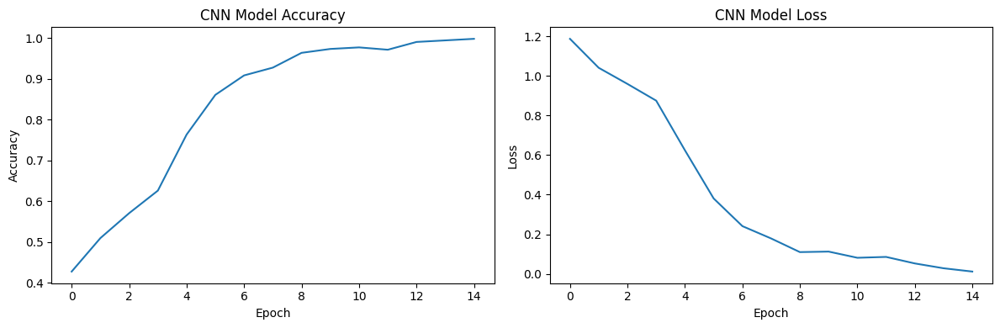

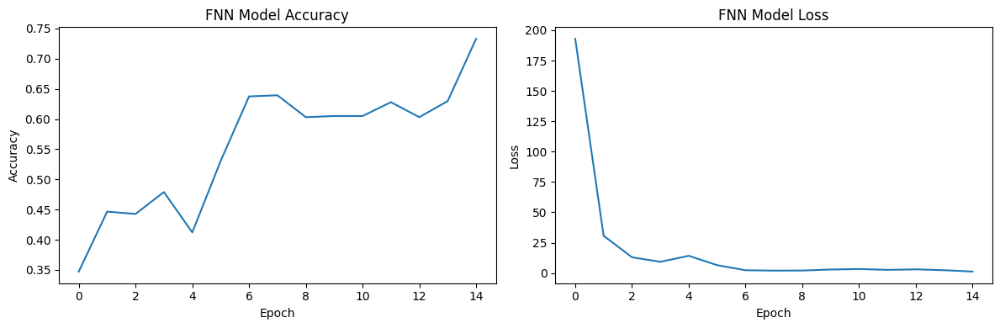

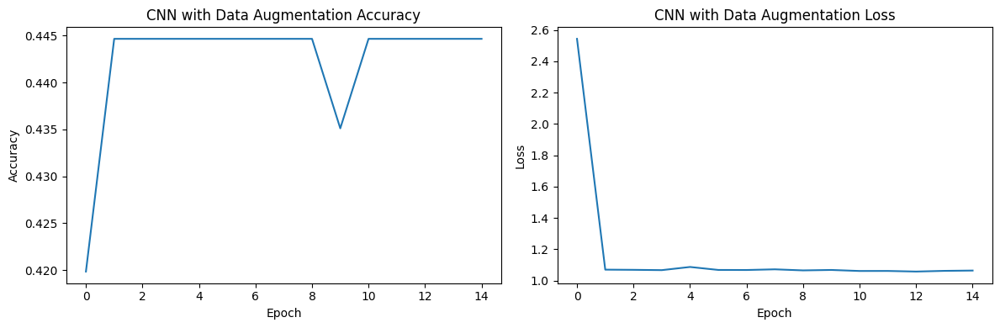

In [28]:
def plot_history(history, title):
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'])
    plt.title(f'{title} Accuracy')
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')

    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'])
    plt.title(f'{title} Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')

    plt.tight_layout()
    plt.show()


# Plot training history for each model
plot_history(histories["CNN"], 'CNN Model')
plot_history(histories["FNN"], 'FNN Model')
plot_history(histories["CNN_GEN"], 'CNN with Data Augmentation')

- **Evaluate Models**


CNN Evaluation:
1/1 [==============================] - 0s 70ms/step

Classification Report:
                 precision    recall  f1-score   support

walking_running       0.43      0.88      0.58        41
        sitting       0.44      0.33      0.38        42
       standing       0.24      0.08      0.12        49

       accuracy                           0.41       132
      macro avg       0.37      0.43      0.36       132
   weighted avg       0.36      0.41      0.35       132



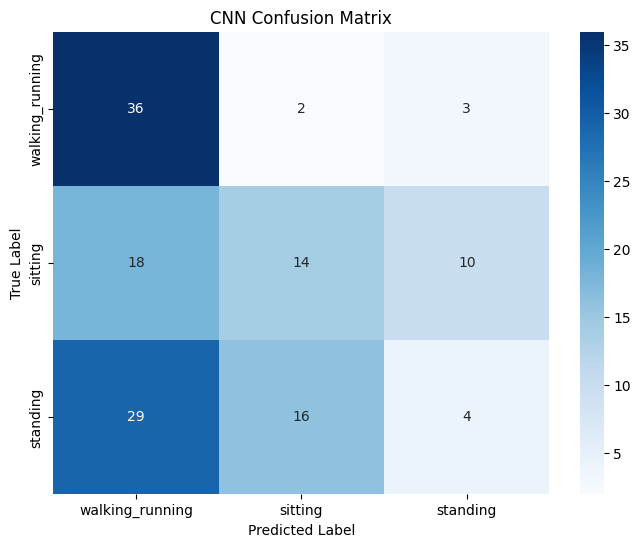

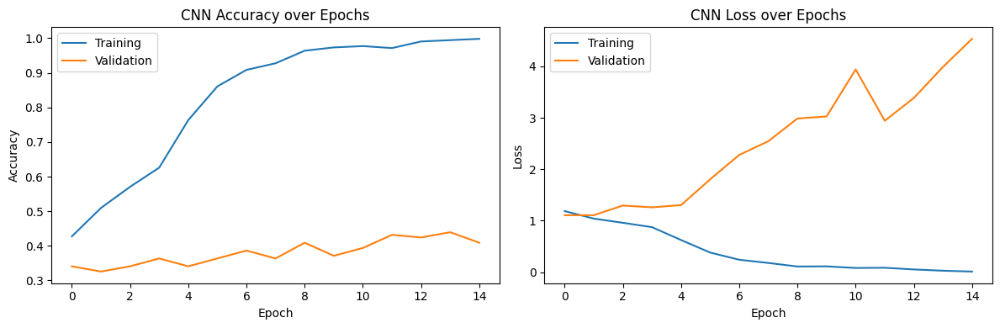


FNN Evaluation:
1/1 [==============================] - 0s 49ms/step

Classification Report:
                 precision    recall  f1-score   support

walking_running       0.34      0.71      0.46        41
        sitting       0.41      0.21      0.28        42
       standing       0.33      0.16      0.22        49

       accuracy                           0.35       132
      macro avg       0.36      0.36      0.32       132
   weighted avg       0.36      0.35      0.31       132



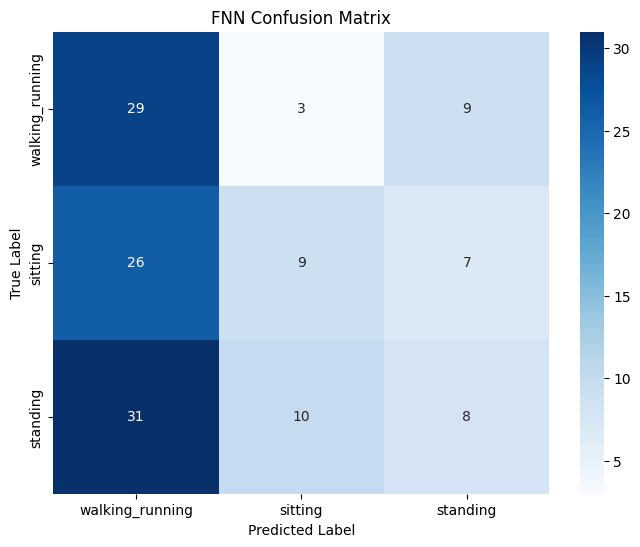

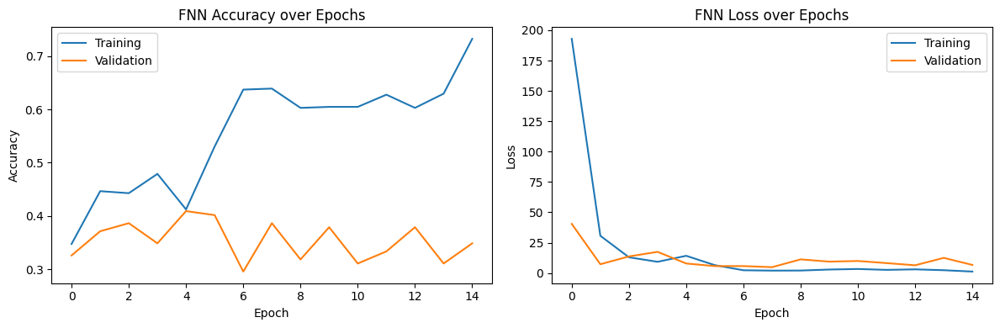


CNN_GEN Evaluation:
1/1 [==============================] - 0s 139ms/step

Classification Report:
                 precision    recall  f1-score   support

walking_running       0.31      1.00      0.47        41
        sitting       0.00      0.00      0.00        42
       standing       0.00      0.00      0.00        49

       accuracy                           0.31       132
      macro avg       0.10      0.33      0.16       132
   weighted avg       0.10      0.31      0.15       132



c:\Users\javie\Desktop\ABERDEEN\Data mining with deep learning\Project 1\preprocess-images\venv\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\javie\Desktop\ABERDEEN\Data mining with deep learning\Project 1\preprocess-images\venv\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\javie\Desktop\ABERDEEN\Data mining with deep learning\Project 1\preprocess-images\venv\Lib\site-packages\sklearn\metrics\_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set 

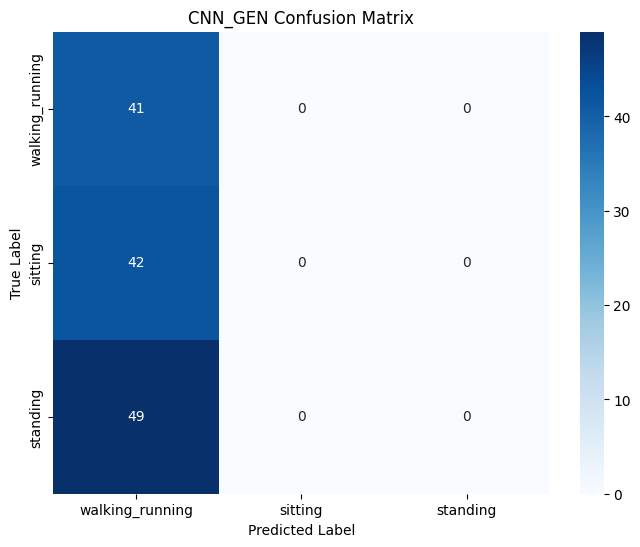

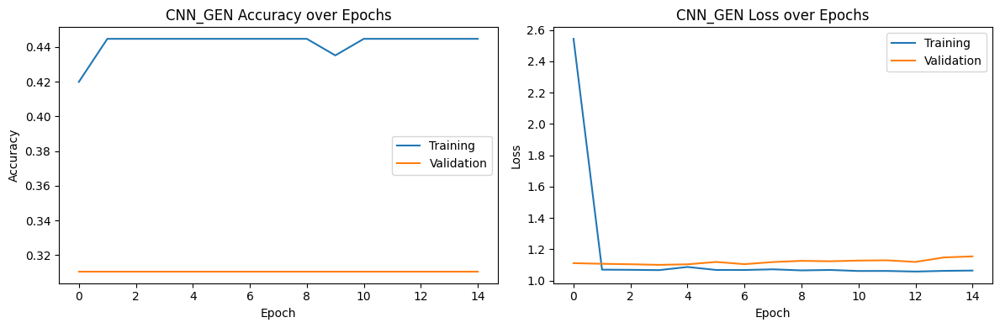

In [29]:
# Evaluate models and display metrics
def evaluate_model(model, model_name, test_ds):
    print(f"\n{model_name} Evaluation:")
    # Get predictions
    y_pred = []
    y_true = []
    for images, labels in test_ds:
        predictions = model.predict(images)
        y_pred.extend(np.argmax(predictions, axis=1))
        y_true.extend(labels.numpy())
    
    # Print classification report
    print("\nClassification Report:")
    print(classification_report(y_true, y_pred, 
          target_names=['walking_running', 'sitting', 'standing']))
    
    # Plot confusion matrix
    plt.figure(figsize=(8, 6))
    cm = confusion_matrix(y_true, y_pred)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
                xticklabels=['walking_running', 'sitting', 'standing'],
                yticklabels=['walking_running', 'sitting', 'standing'])
    plt.title(f'{model_name} Confusion Matrix')
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.show()
    
    # Plot training history
    plt.figure(figsize=(12, 4))
    
    plt.subplot(1, 2, 1)
    plt.plot(histories[model_name].history['accuracy'], label='Training')
    plt.plot(histories[model_name].history['val_accuracy'], label='Validation')
    plt.title(f'{model_name} Accuracy over Epochs')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    
    plt.subplot(1, 2, 2)
    plt.plot(histories[model_name].history['loss'], label='Training')
    plt.plot(histories[model_name].history['val_loss'], label='Validation')
    plt.title(f'{model_name} Loss over Epochs')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    
    plt.tight_layout()
    plt.show()

# Evaluate each model
for model_name, model in models_dict.items():
    evaluate_model(model, model_name, test_ds)

- **Model evaluation**

In [30]:
print("\nModel Performance on Test Dataset:")
print("-" * 40)

try:
    # CNN evaluation
    cnn_loss, cnn_accuracy = models_dict["CNN"].evaluate(
        test_ds, 
        verbose=0
    )
    print(f'CNN Test Accuracy: {cnn_accuracy:.2%}')
    print(f'CNN Test Loss: {cnn_loss:.4f}')

    # FNN evaluation
    fnn_loss, fnn_accuracy = models_dict["FNN"].evaluate(
        test_ds, 
        verbose=0
    )
    print(f'FNN Test Accuracy: {fnn_accuracy:.2%}')
    print(f'FNN Test Loss: {fnn_loss:.4f}')

    # CNN with data augmentation evaluation
    cnn_gen_loss, cnn_gen_accuracy = models_dict["CNN_GEN"].evaluate(
        test_ds, 
        verbose=0
    )
    print(f'CNN with Data Augmentation Test Accuracy: {cnn_gen_accuracy:.2%}')
    print(f'CNN with Data Augmentation Test Loss: {cnn_gen_loss:.4f}')

except Exception as e:
    print(f"Error during model evaluation: {str(e)}")

print("-" * 40)


Model Performance on Test Dataset:
----------------------------------------
CNN Test Accuracy: 40.91%
CNN Test Loss: 4.5341
FNN Test Accuracy: 34.85%
FNN Test Loss: 6.6760
CNN with Data Augmentation Test Accuracy: 31.06%
CNN with Data Augmentation Test Loss: 1.1542
----------------------------------------


- **Try models**

In [32]:
def predict_and_visualize(image_path, model):
    """
    Load an image, detect humans, predict their activity labels,
    and visualize the results with bounding boxes and labels.
    
    Args:
        image_path: Path to the input image
        model: The trained model to use for prediction
    """
    # Step 1: Load the image
    original_image = cv2.imread(image_path)
    if original_image is None:
        print(f"Could not read image: {image_path}")
        return
    
    # Convert to RGB for visualization (OpenCV uses BGR)
    display_image = cv2.cvtColor(original_image.copy(), cv2.COLOR_BGR2RGB)
    
    # Step 2: Load YOLO model for human detection
    net = cv2.dnn.readNetFromDarknet(
        "./yolo_files/yolov3.cfg", 
        "./yolo_files/yolov3.weights"
    )
    
    # Get image dimensions
    height, width = original_image.shape[:2]
    
    # Create blob from image
    blob = cv2.dnn.blobFromImage(original_image, 1/255.0, (416, 416), swapRB=True, crop=False)
    
    # Set input to the network
    net.setInput(blob)
    
    # Get output layer names
    layer_names = net.getLayerNames()
    output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers().flatten()]
    
    # Forward pass
    outputs = net.forward(output_layers)
    
    # Process detections
    class_ids = []
    confidences = []
    boxes = []
    
    for output in outputs:
        for detection in output:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            
            # Filter for person class (class ID 0 in COCO dataset)
            if class_id == 0 and confidence > 0.5:
                # Object detected is a person with confidence > 50%
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)
                w = int(detection[2] * width)
                h = int(detection[3] * height)
                
                # Rectangle coordinates
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)
                
                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                class_ids.append(class_id)
    
    # Apply non-maximum suppression
    indices = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)
    
    # Class labels for prediction
    activity_labels = ['walking_running', 'sitting', 'standing']
    
    # Colors for different activities
    colors = {
        'walking_running': (0, 255, 0),  # Green
        'sitting': (255, 165, 0),        # Orange
        'standing': (0, 0, 255)          # Blue
    }
    
    # Step 3: For each detected person, predict activity
    plt.figure(figsize=(12, 12))
    plt.imshow(display_image)
    
    if len(indices) > 0:
        for i in indices.flatten():
            x, y, w, h = boxes[i]
            
            # Ensure box is within image boundaries
            x, y = max(0, x), max(0, y)
            w = min(width - x, w)
            h = min(height - y, h)
            
            # Crop the person from the image
            person_crop = original_image[y:y+h, x:x+w]
            
            # Preprocess for model prediction
            resized_crop = cv2.resize(person_crop, (256, 256))
            normalized_crop = resized_crop.astype(np.float32) / 255.0
            
            # Make prediction
            prediction = model.predict(np.expand_dims(normalized_crop, axis=0), verbose=0)
            predicted_class_idx = np.argmax(prediction[0])
            predicted_label = activity_labels[predicted_class_idx]
            confidence = prediction[0][predicted_class_idx]
            
            # Get color for this activity
            color = colors[predicted_label]
            
            # Draw rectangle on the image
            rect = plt.Rectangle((x, y), w, h, 
                                 linewidth=2, edgecolor=np.array(color)/255, 
                                 facecolor='none')
            plt.gca().add_patch(rect)
            
            # Add label with confidence
            plt.text(x, y-10, f"{predicted_label} ({confidence:.2f})", 
                     color='white', fontsize=12, 
                     bbox=dict(facecolor=np.array(color)/255, alpha=0.8))
    else:
        plt.title("No humans detected in the image")
    
    plt.axis('off')
    plt.tight_layout()
    plt.show()

- **CNN**

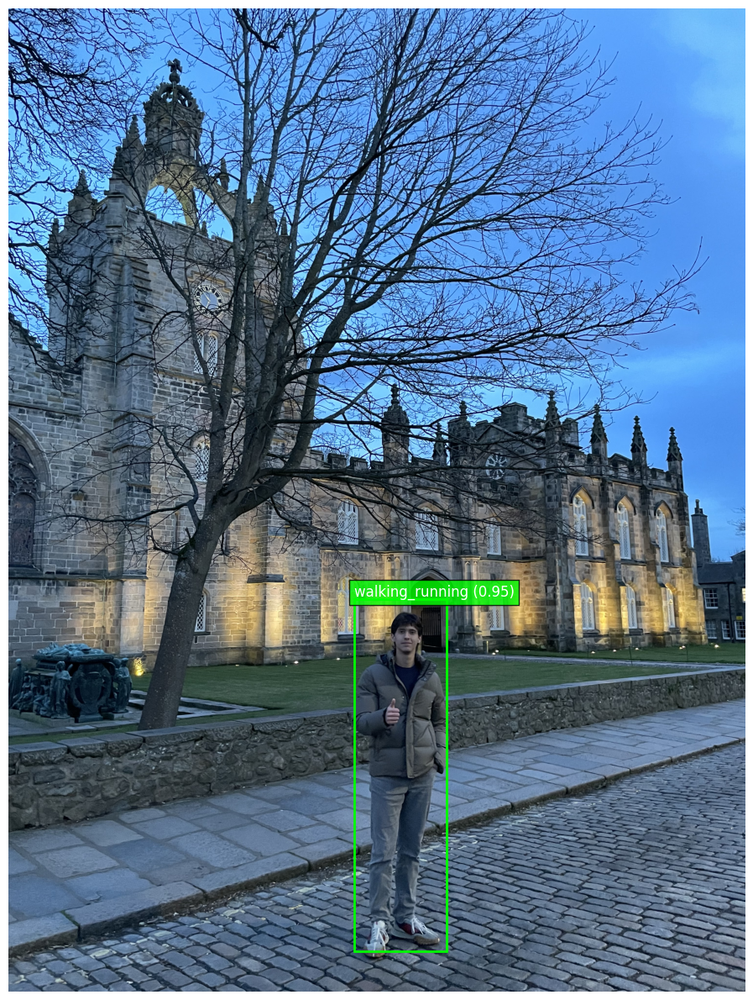

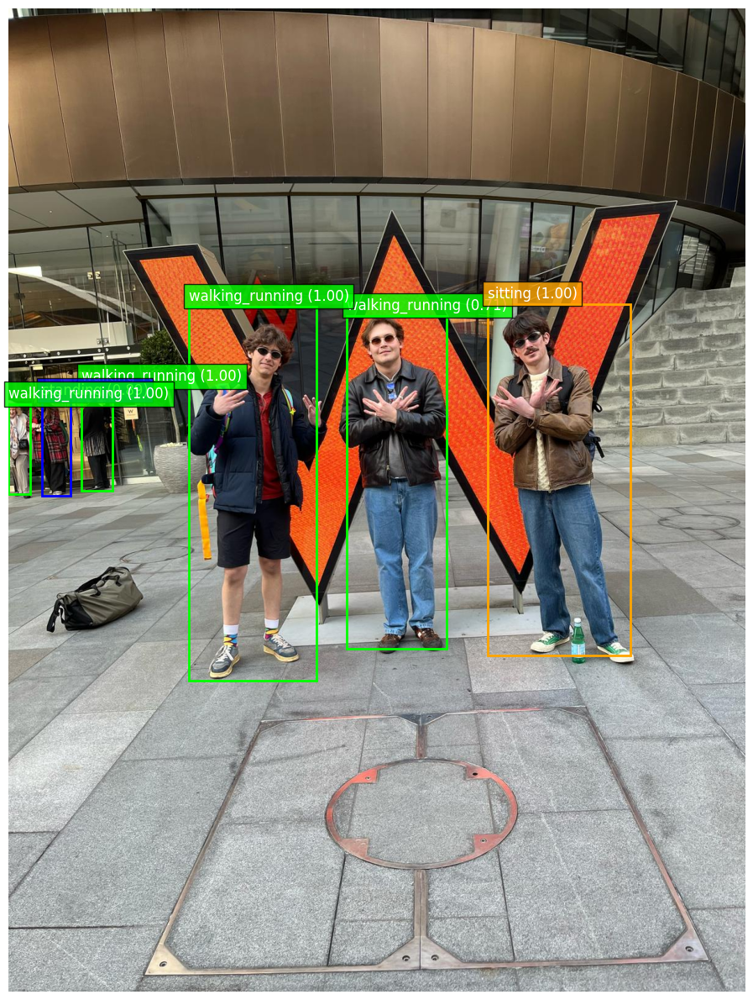

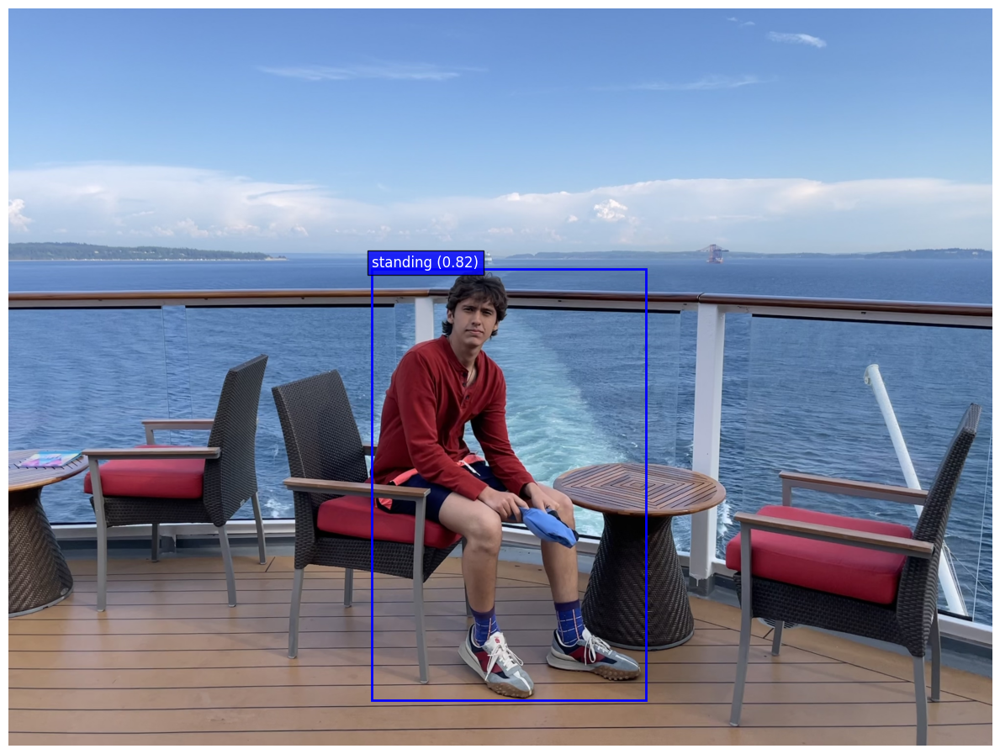

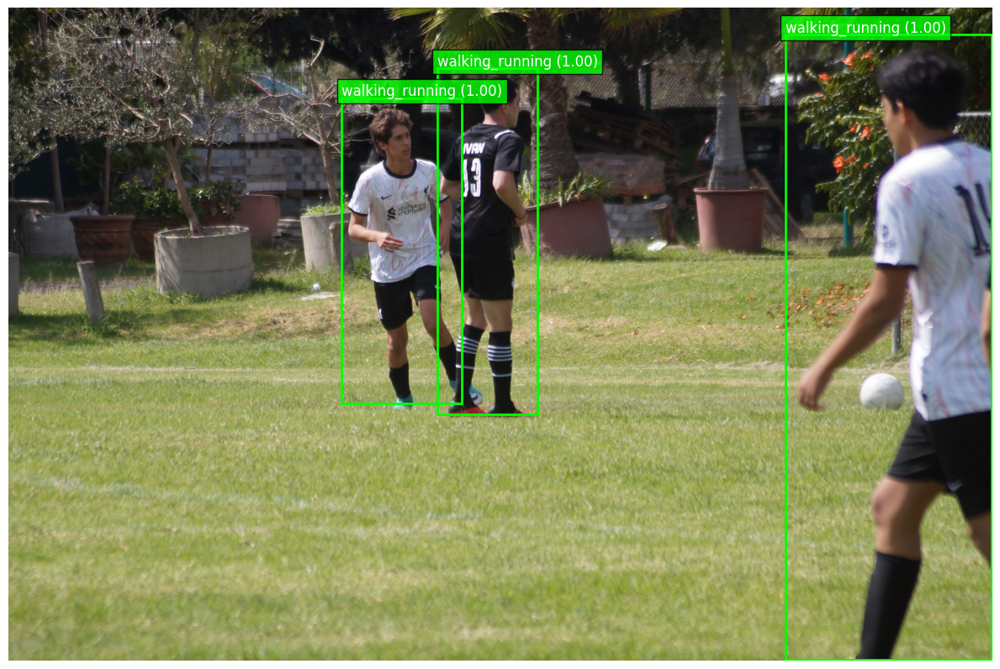

In [36]:
predict_and_visualize("./try_examples/img_1.jpg", models_dict["CNN"])  
predict_and_visualize("./try_examples/img_2.jpg", models_dict["CNN"])  
predict_and_visualize("./try_examples/img_3.jpg", models_dict["CNN"])  
predict_and_visualize("./try_examples/img_4.jpg", models_dict["CNN"])  

- **FNN**

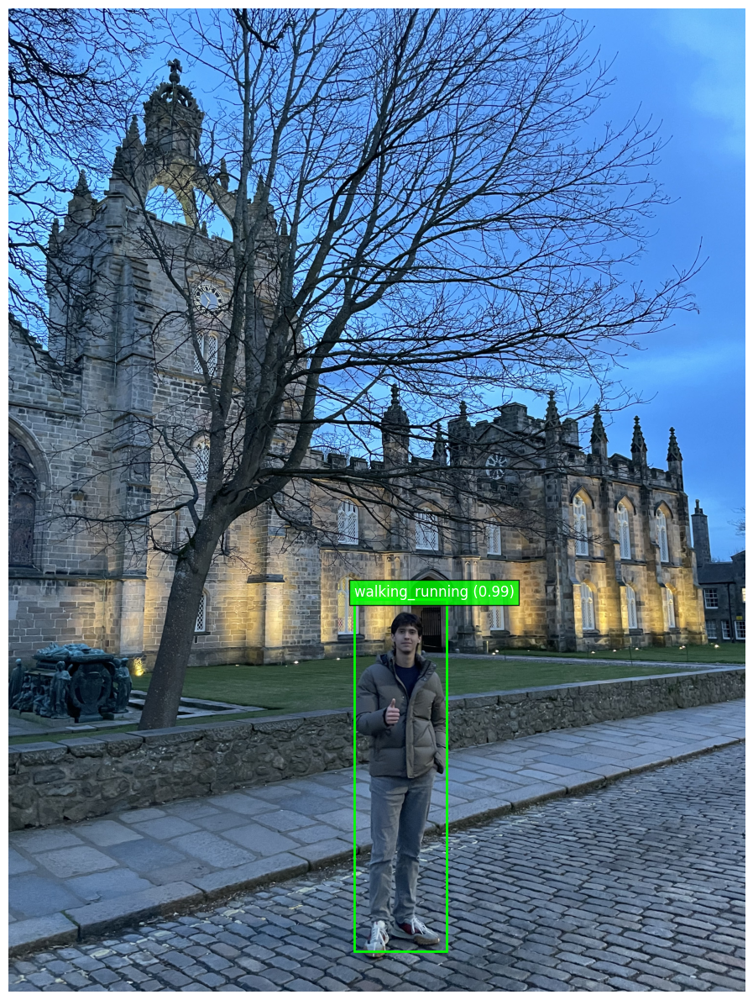

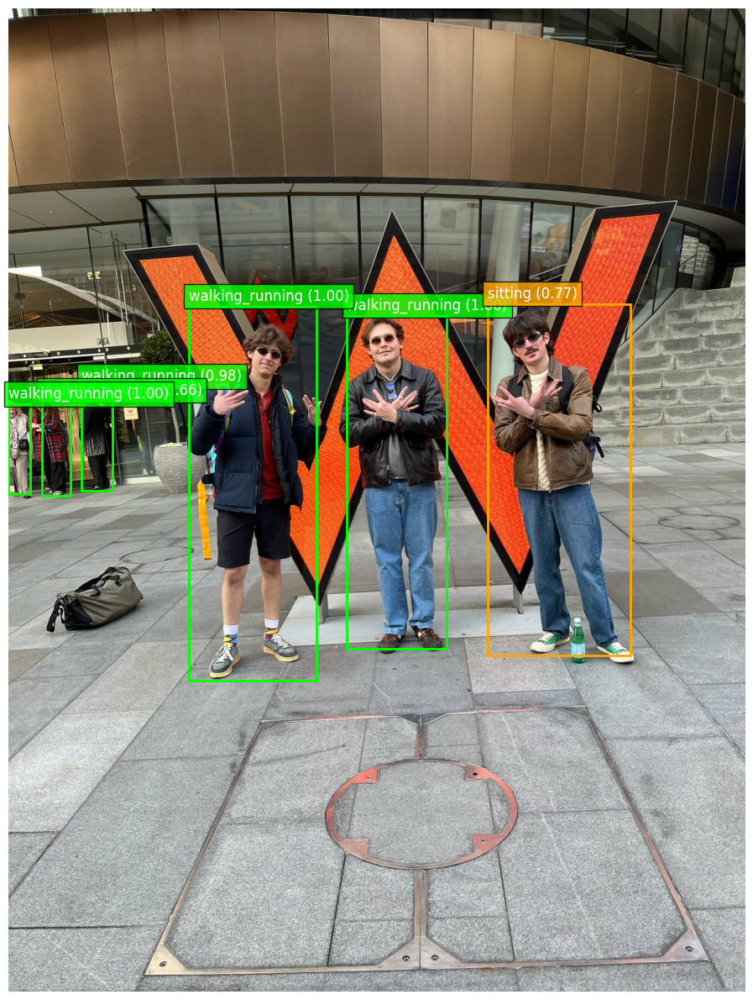

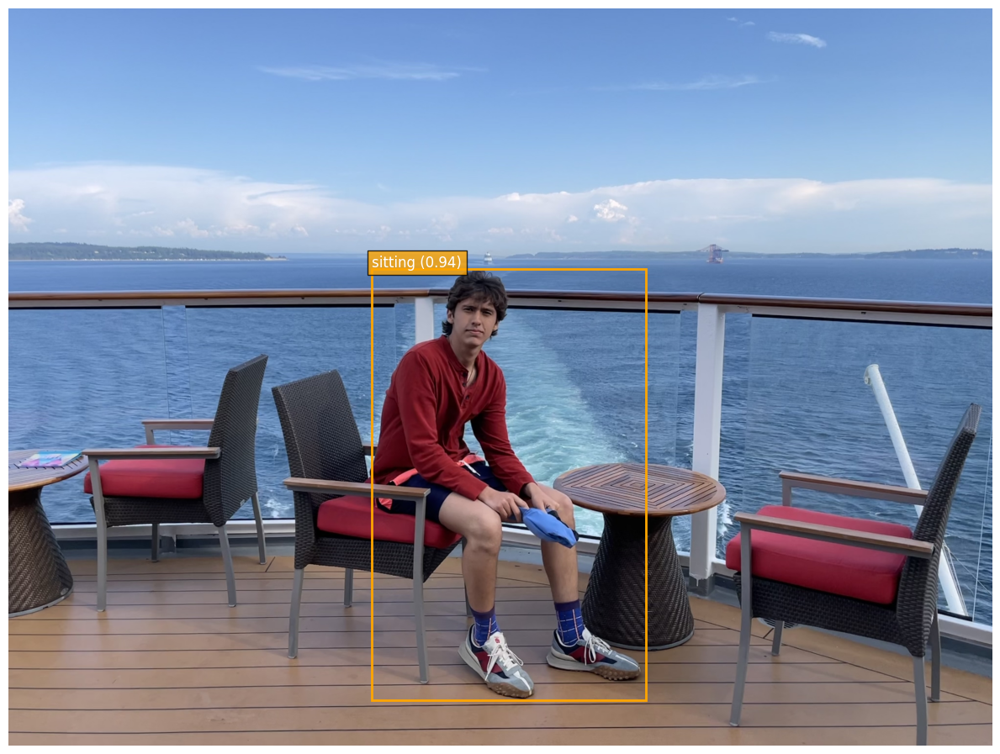

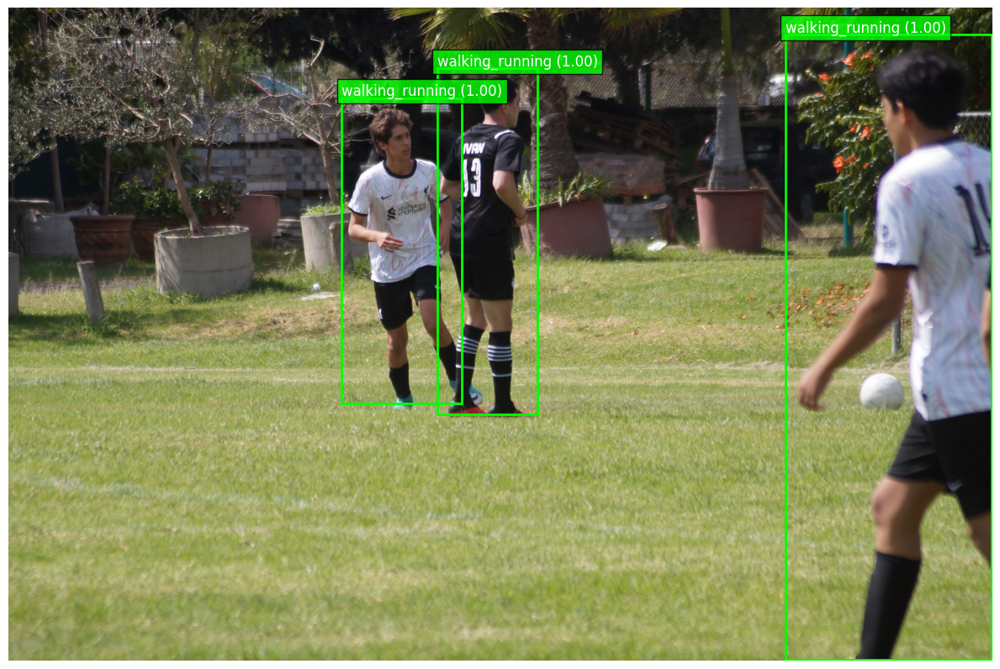

In [37]:
predict_and_visualize("./try_examples/img_1.jpg", models_dict["FNN"])  
predict_and_visualize("./try_examples/img_2.jpg", models_dict["FNN"])  
predict_and_visualize("./try_examples/img_3.jpg", models_dict["FNN"])  
predict_and_visualize("./try_examples/img_4.jpg", models_dict["FNN"])  

- **CNN with data augmentation**

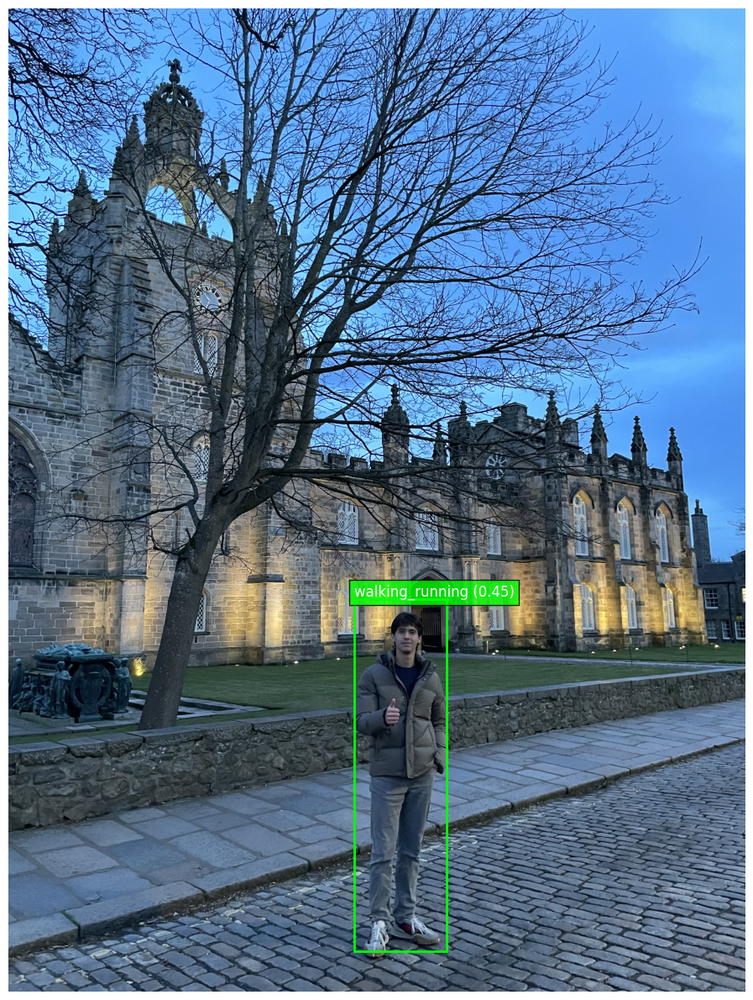

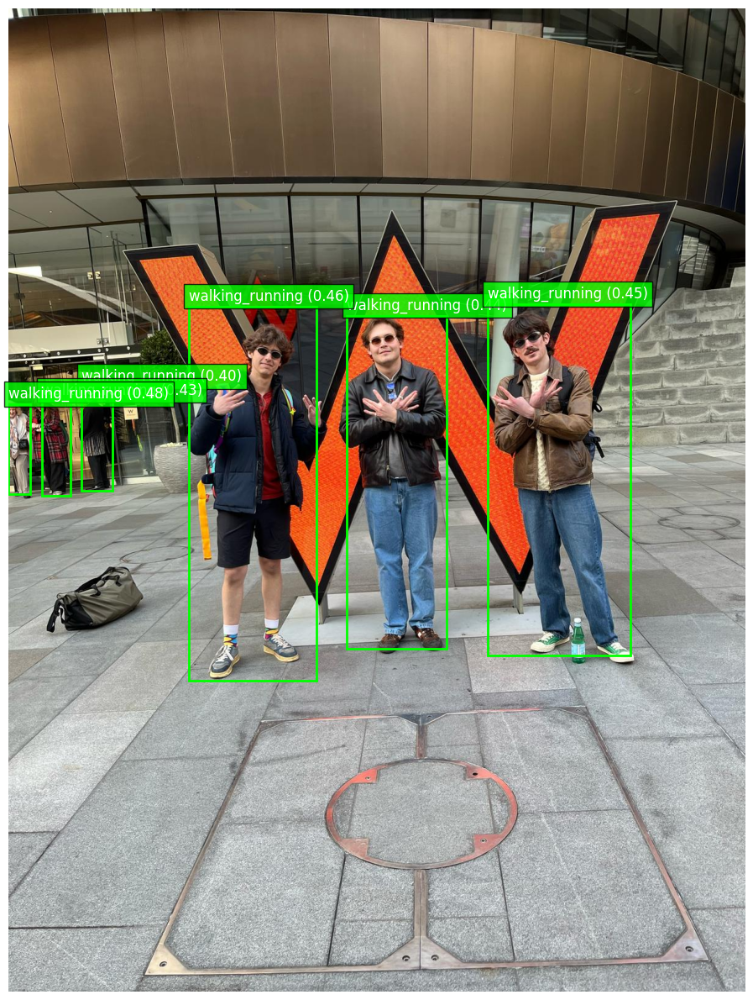

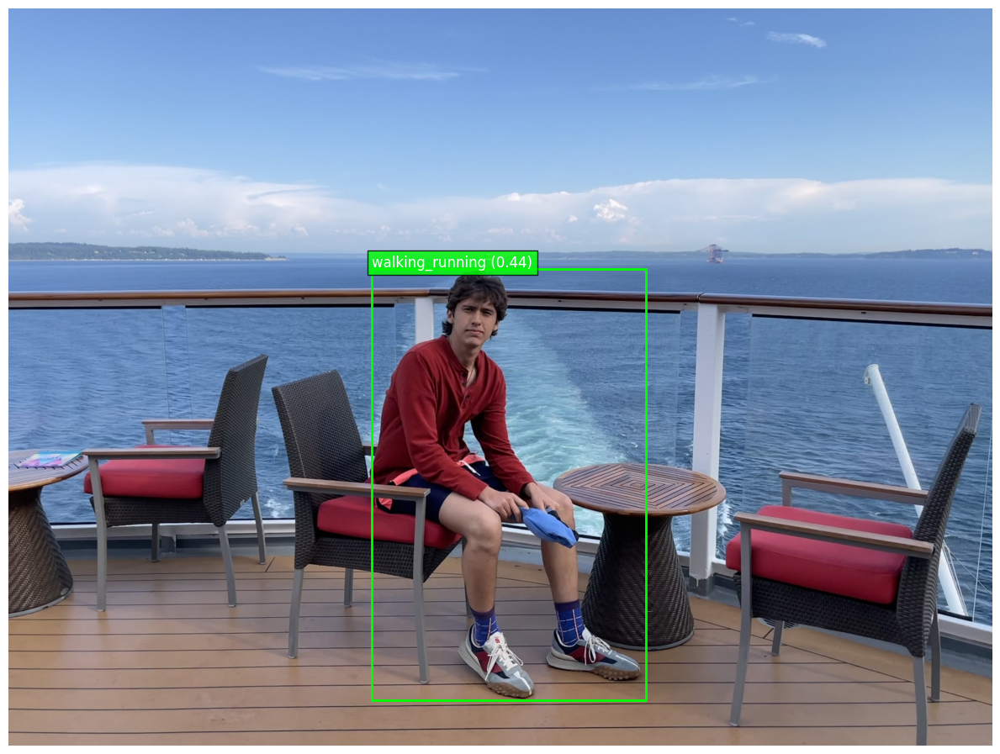

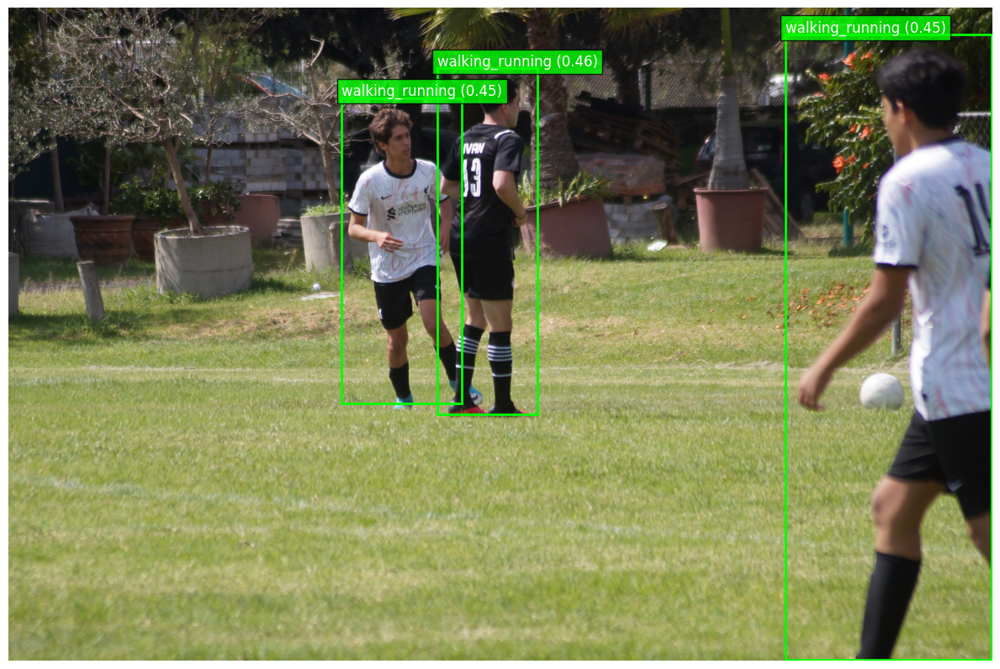

In [38]:
predict_and_visualize("./try_examples/img_1.jpg", models_dict["CNN_GEN"])  
predict_and_visualize("./try_examples/img_2.jpg", models_dict["CNN_GEN"])  
predict_and_visualize("./try_examples/img_3.jpg", models_dict["CNN_GEN"])  
predict_and_visualize("./try_examples/img_4.jpg", models_dict["CNN_GEN"])  